<a href="https://colab.research.google.com/github/chineych/DataScienceIBM/blob/master/Assignment_1_MIN_E_422.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Load the Required Libraries**

The following code loads the required libraries.


In [ ]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
import glob
import os

If you get a package import error, you may have to first install some of these packages. This can usually be accomplished by typing '!pip install [package-name]'. More assistance is available with the respective package docs.

In [ ]:
pip install opencv-python

**ACCESSING FILES**

Since Google Colab uses a cloud service, it does not have access to your cloud driver. The program below lets you access your drive. Run the code, click the link, and then paste the code you get inside the input. The path will be “/content/gdrive/”.

In [ ]:
from google.colab import drive
drive.mount("gdrive") 

Drive already mounted at gdrive; to attempt to forcibly remount, call drive.mount("gdrive", force_remount=True).


**Set the working directory**

I always like to do this so I don't lose the location of the files and to simplify subsequent read and writes 

In [ ]:
!mkdir Assignment_1

mkdir: cannot create directory ‘Assignment_1’: File exists


**Create the necessary folders to organize input and output data**

In [ ]:
os.makedirs('/content/Assignment_1/Original_Video') 

FileExistsError: ignored

In [ ]:
os.makedirs('/content/Assignment_1/yolo_data') 

In [ ]:
os.makedirs('/content/Assignment_1/Images_from_video') 

In [ ]:
os.makedirs('/content/Assignment_1/final_images') 

**CONVERTING VIDEO FILE TO IMAGES**

In Google Colab, live capturing from cameras are disabled, so we will just process the program using images instead. First, we need to use the function ‘cv.VideoCapture()’ with the parameters being the path to the file. Now we will take a frame of that video using the function ‘capture.read()’ and save it to the directory (in this case it will be saved under “/content/Assignment_1/Images_from_video”).

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
video = "/content/gdrive/MyDrive/Colab Notebooks/MinE422Assignment1.mp4"
capture = cv.VideoCapture(video)
isTrue, frame = capture.read()
count = 0
while isTrue:
  isTrue, frame = capture.read()
  if not isTrue:
    break
  cv.imwrite("/content/Assignment_1/Images_from_video/frame%03d.jpg" %count, frame)
  count += 1

**IMPORT OUR CLASS IDS**

Next is to import the file that will be consisting of our weights, config, and names. Since we are using YOLO3, we will be using the coco set consisting of 80 common objects like “person”, “cup”, “cell phone”, etc. The weights themselves are indexed and do not have a name associated with that index, so we will be making that below.

We will first open the text file name ‘coco.names’ using ‘with open() as f’ with the first parameter being the file name and the second parameter being the read type. The variable ‘classNames’ will store a list consisting of the names in the correct index. ‘f.read()’ just reads the whole file as a string, then ‘.split’ splits the string into a list separated by the newline.


In [ ]:
importClassNames = "/content/gdrive/MyDrive/Colab Notebooks/coco.names"
classNames = []
with open(importClassNames, "r") as f: 
    classNames = f.read().split("\n")

If I were to print the output of ‘classNames’ after running this code, I get an output looking like this:

In [ ]:
classNames

Next, we will create the machine learning algorithm using the two files found on this website. The machine-learning algorithm uses a deep neural network (dnn). We will be using the variable ‘net’ later.

In [ ]:
import cv2 as cv
modelConfiguation = "/content/gdrive/MyDrive/Colab Notebooks/yolov3.cfg" 
modelWeights = "/content/gdrive/MyDrive/Colab Notebooks/yolov3.weights"  
net = cv.dnn.readNet(modelConfiguation, modelWeights)

**CONVERTING ‘FRAME’ TO BE USED IN THE ALGORITHM**

Right now the picture cannot be processed in the machine learning algorithm, So we will convert the frame into something called a ‘blob’. ‘cv.dnn.blobFromImage()’ takes in a few parameters: image, scale factor, size, mean, swap RB, crop.


We will then send the input of the blob into the network. The ‘layerNames’ variable gets all the variable names of our layers in the network.
Next, we have to extract the output layers using the function ‘network.getUnconnectedOutlayers()’. Note that we are just getting the index of the output, so we will use the index and refer it back to the ‘layerNames’. Since the network does not use the index ‘0’ and starts the index at ‘1’, and our output names start at ‘0’, we will shift the index by ‘-1’.
Next, we will make a variable called ‘outputs’ that forwards the ‘outputNames’ to the network using the function ‘net.forward’.
Now the network has a bunch of values including the bounding box, as well as its percentages, so the next part of the programs start filtering those results to be displayed later.


Outputs will be the results we will need to display results.

In [ ]:
def getOutputs(frame):
    blob = cv.dnn.blobFromImage(frame, 1/255, # ---> 
          (widthheight, widthheight), [0, 0, 0], 1, crop = False)
    net.setInput(blob)
    layerNames = net.getLayerNames() 
    outputNames = [layerNames[i[0] - 1] # ---> 
          for i in net.getUnconnectedOutLayers()]
    outputs = net.forward(outputNames) 
    return outputs

**CREATING WHAT TO BE DISPLAYED**

Now that we have the results, we will now make an algorithm to display the highest probability of that object in the bounding box. First, note that the output consists of 85 values instead of 80 from our name list. The first 5 values are as followed: center x, center y, width, height, confidence object present. The rest of the 80 values are the probability of that object displayed. We will make a new variable ‘scores‘ consisting of only the probability of those objects. We will then get the ‘classID’ of the max probability of that object. We will also get that probability value by finding the index of the scores and put it in ‘confidence’.

The next thing is to check if the probability of that object is higher than our threshold. If it is we will make a bounding box for it and append the confidence value and class ID to our lists. To make a bounding box, we will need 4 variables: x and y coordinates, the width, and the height of the bounding box. The code below edits the center x and y coordinate to the respective coordinate.

The variable ‘outputBox’ removes unnecessary boxes, and this is controlled by the variable ‘nmsThreshold’. We will finally display the boxes to the window using ‘cv.rectangle()’, ‘cv.putText()’, as shown below iterating through ‘outputBox’. ‘cv.rectangle()’ takes in the image, first coordinate, second coordinate, color, and the thickness. ‘cv.putText()’ has a few parameters like the image, displayed text, coordinate, font, font size, color, thickness. We have calculated the coordinates for the boxes to be displayed from the bounding boxes, and the displayed text from the other lists.

In [ ]:
import numpy as np
def displayBox(outputs):
    height, width, channels = frame.shape  
    boundingBox = []   
    classIDs = []      
    confidenceValues = []   
    for output in outputs:
        for values in output:  
            scores = values[5:] 
            classID = np.argmax(scores)  
            confidence = scores[classID] 
            if confidence > confidenceThreshold:  
                w, h = int(values[2] * width), int(values[3] * height) 
                x, y = int(values[0] * width - w/2),int(values[1] * height - h/2)  
                boundingBox.append([x, y, w, h])  
                classIDs.append(classID) 
                confidenceValues.append(float(confidence)) 
    outputBox = cv.dnn.NMSBoxes(boundingBox, confidenceValues,confidenceThreshold, nmsThreshold)
    for i in outputBox:
        index = i[0]
        color = colors[classIDs[index]]
        x, y, w, h = boundingBox[index][:4]
        cv.rectangle(frame, (x, y), (x + w, y + h), color, 2)
        label = str(classNames[classIDs[index]].capitalize()) + " " + str(int(confidenceValues[index] * 100)) + " %"
        cv.putText(frame, label,(x + 5, y + 16), font, 0.5, color, 2)

**MAIN FUNCTION**

We will first list off all of our constants here. This is so that we can easily change it later. We will now get all the files using the path ‘/content/’ followed by ‘*.*’ to get all the files in that directory. We will sort them in order of the frame number and now display the file name and the picture with the algorithm for all the frames.

The function ‘glob.glob()‘ gets an unsorted file list of that path directory.
‘Sorted()’ sorts the list into a sorted list by the time the file was made, which is the same as ordering them by number. The ‘frameSize’ is the size of ‘frame’ being used in the network. If this value is smaller, it will take less time for the frame to be processed, sacrificing accuracy. Inside the for loop, I have used “.strip()”. This basically strips the string from the inputted string. In this case, it just removes “/content/” and outputs just the file name. “cv.imread()” captures the image of the file. ‘cv.resize()’ resizes the frame. ‘displayBox()’ and ‘getOuputs‘ are the two functions we have implemented above. ‘cv2_imshow()’ displays the image onto the output. This is the replacement of ‘cv2.imshow()’ since it is disabled in Google Colab.

000.jp


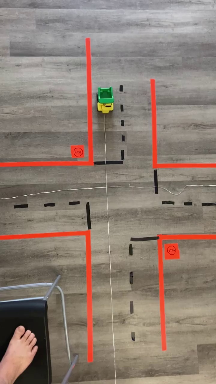

001.jp


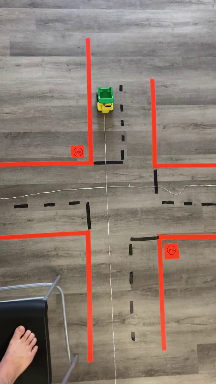

002.jp


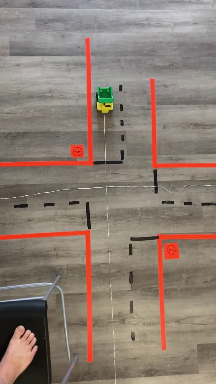

003.jp


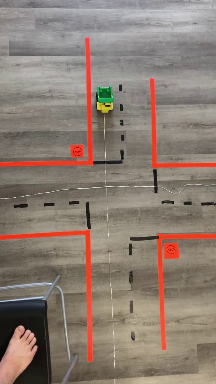

004.jp


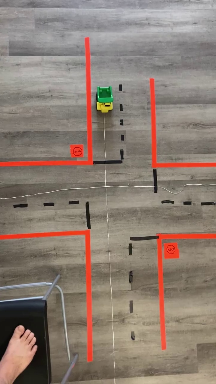

005.jp


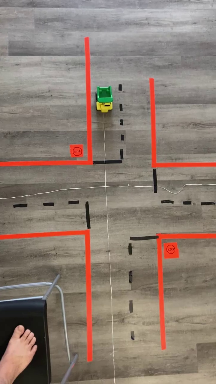

006.jp


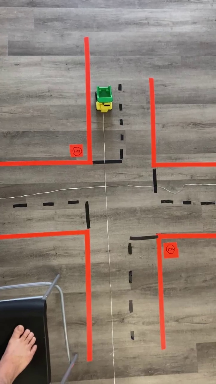

007.jp


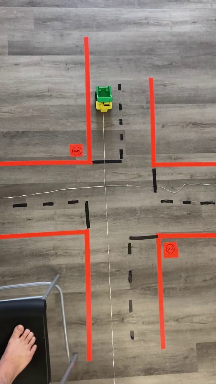

008.jp


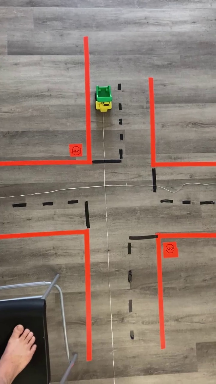

009.jp


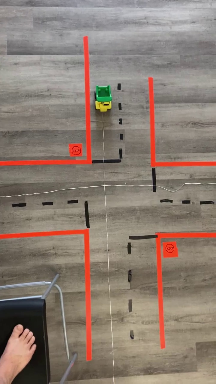

010.jp


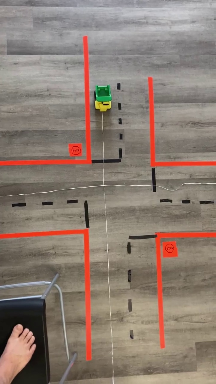

011.jp


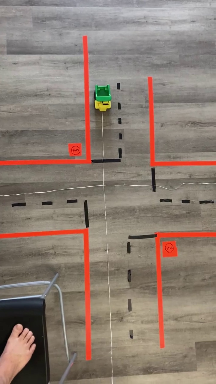

012.jp


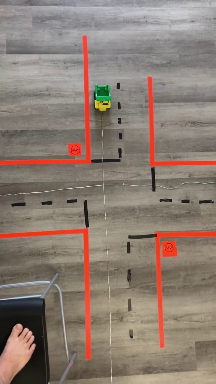

013.jp


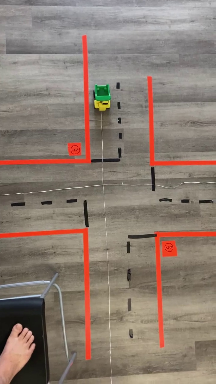

014.jp


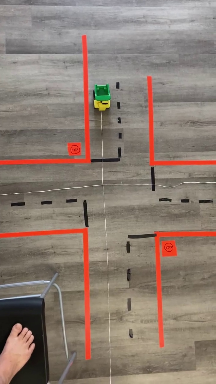

015.jp


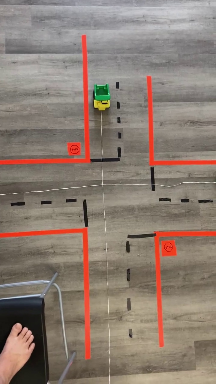

016.jp


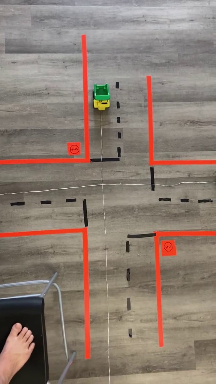

017.jp


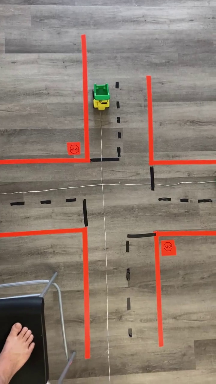

018.jp


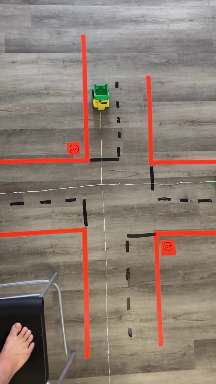

019.jp


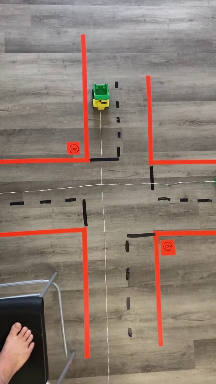

020.jp


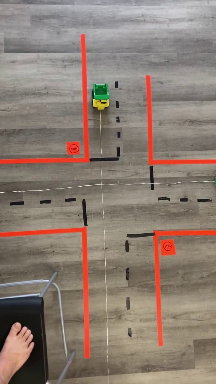

021.jp


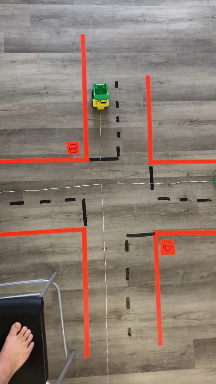

022.jp


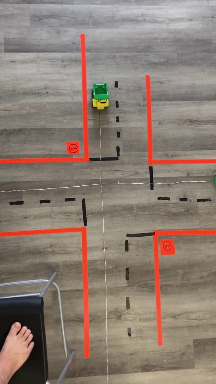

023.jp


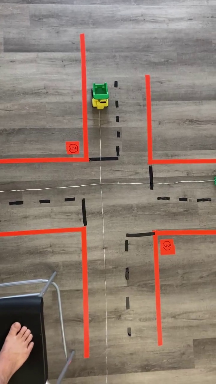

024.jp


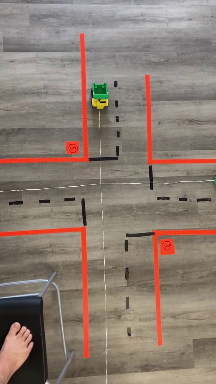

025.jp


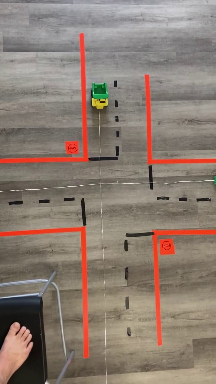

026.jp


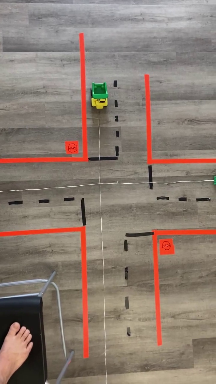

027.jp


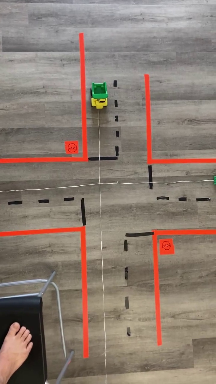

028.jp


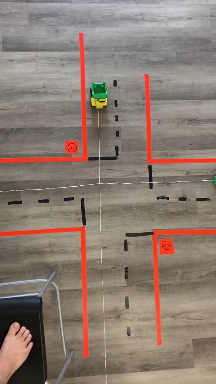

029.jp


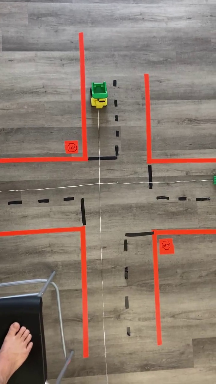

030.jp


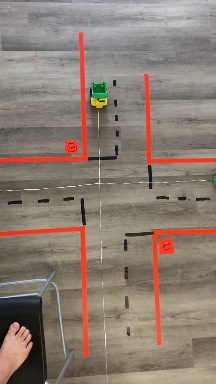

031.jp


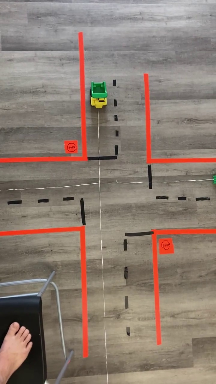

032.jp


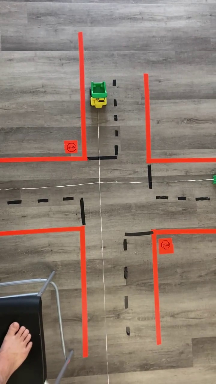

033.jp


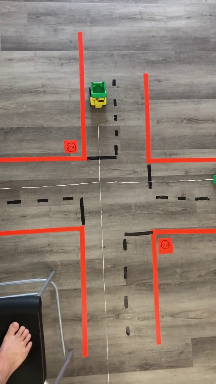

034.jp


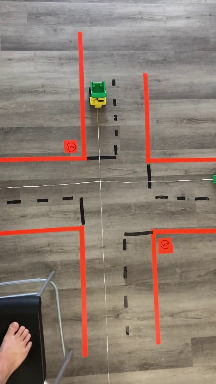

035.jp


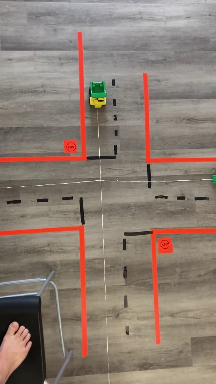

036.jp


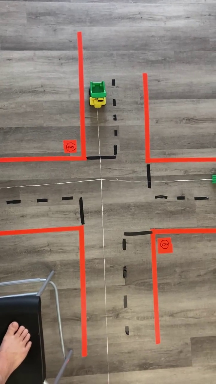

037.jp


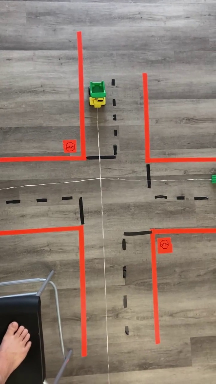

038.jp


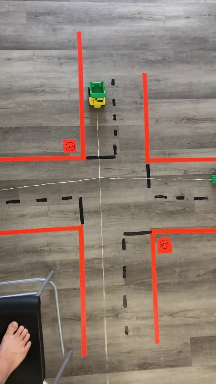

039.jp


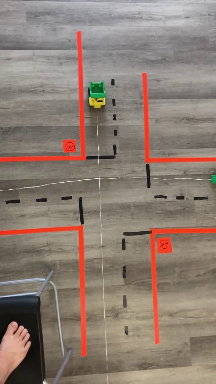

040.jp


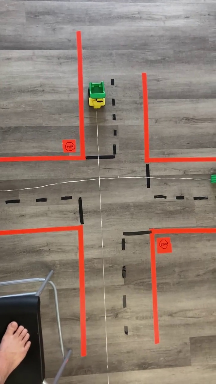

041.jp


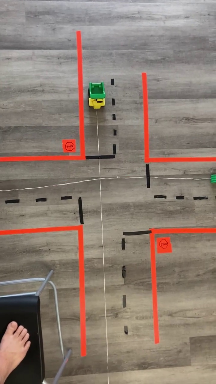

042.jp


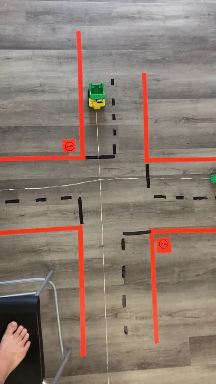

043.jp


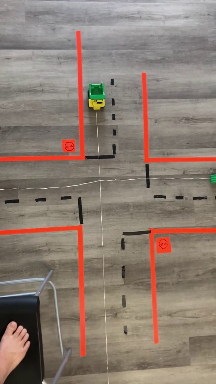

044.jp


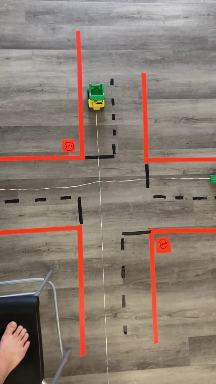

045.jp


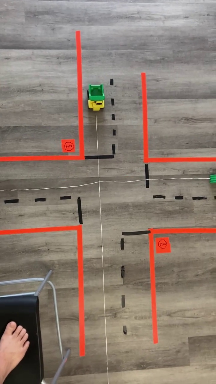

046.jp


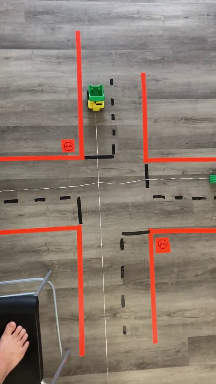

047.jp


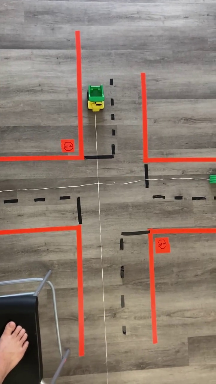

048.jp


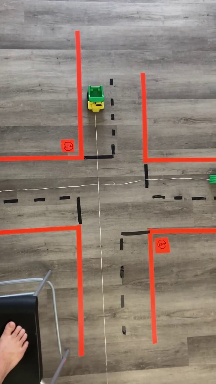

049.jp


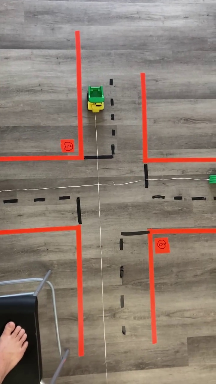

050.jp


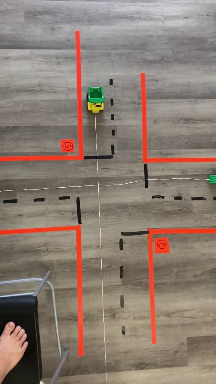

051.jp


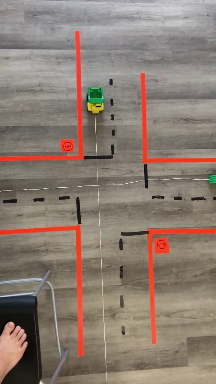

052.jp


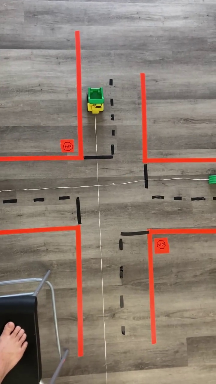

053.jp


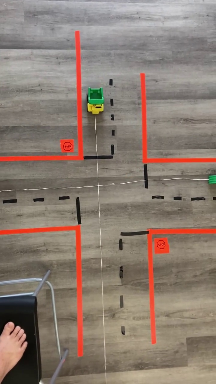

054.jp


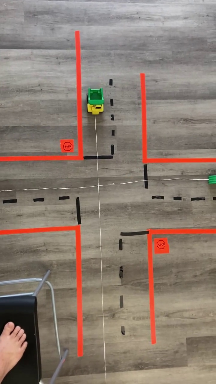

055.jp


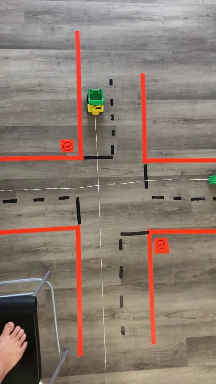

056.jp


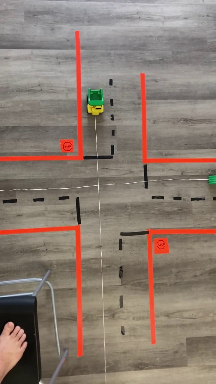

057.jp


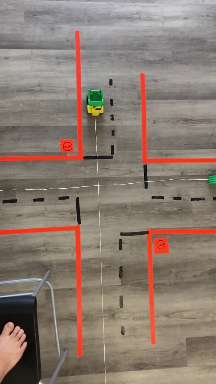

058.jp


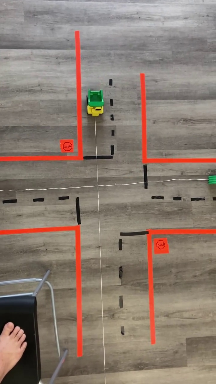

059.jp


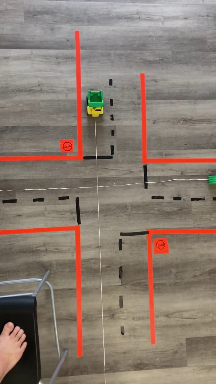

060.jp


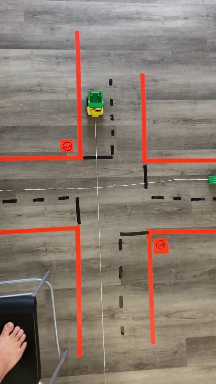

061.jp


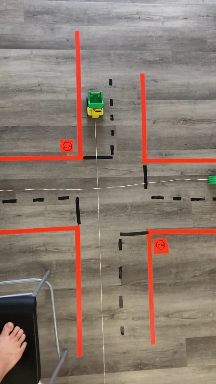

062.jp


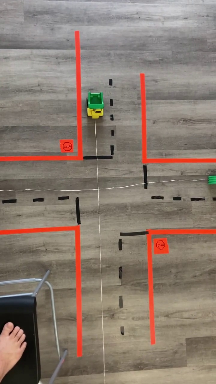

063.jp


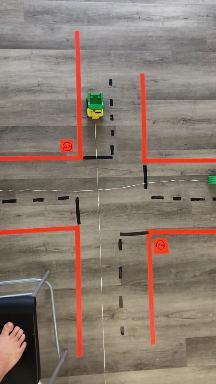

064.jp


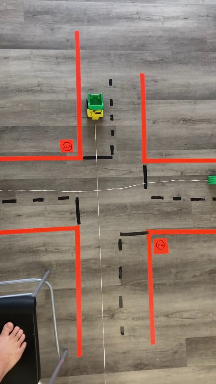

065.jp


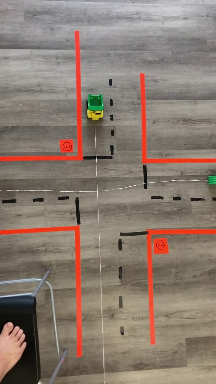

066.jp


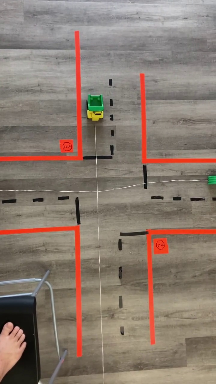

067.jp


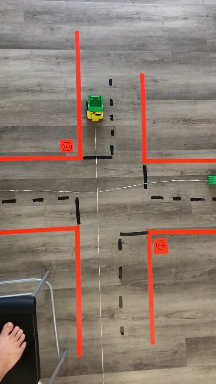

068.jp


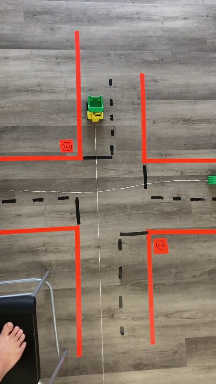

069.jp


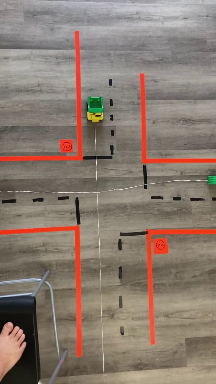

070.jp


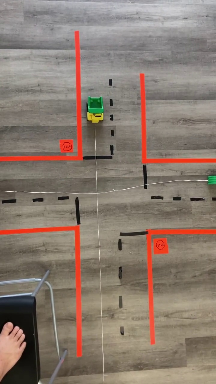

071.jp


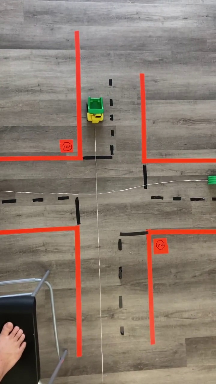

072.jp


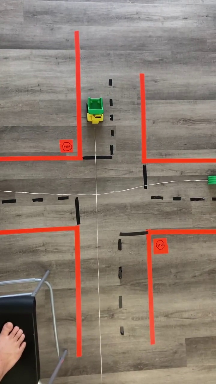

073.jp


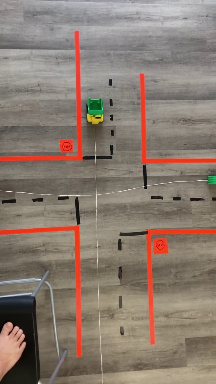

074.jp


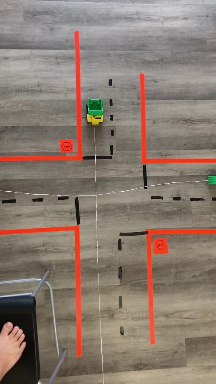

075.jp


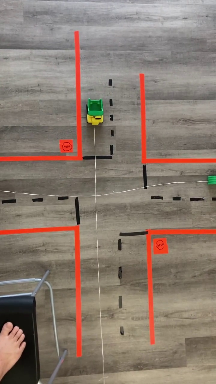

076.jp


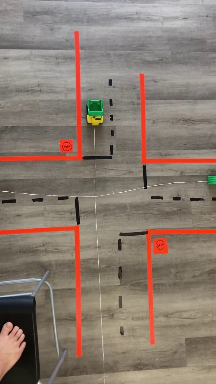

077.jp


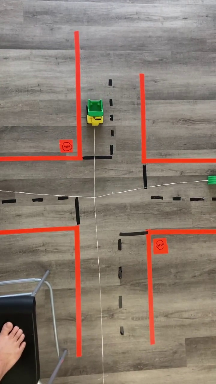

078.jp


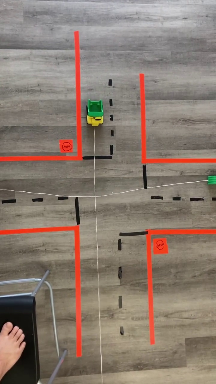

079.jp


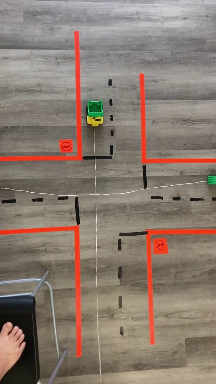

080.jp


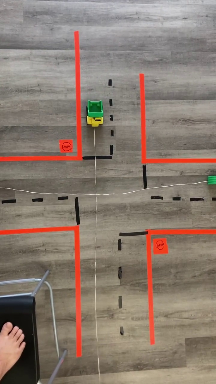

081.jp


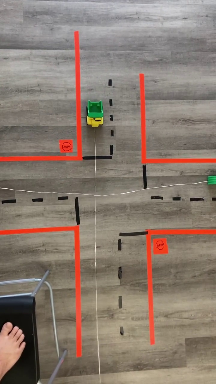

082.jp


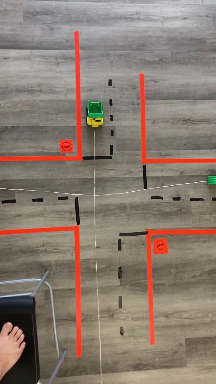

083.jp


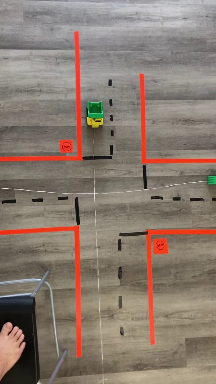

084.jp


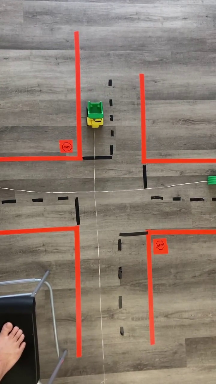

085.jp


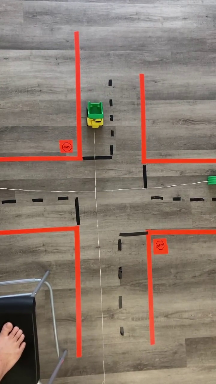

086.jp


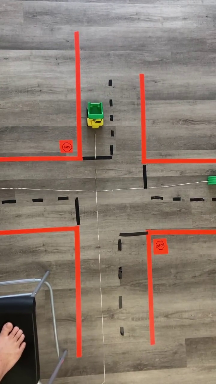

087.jp


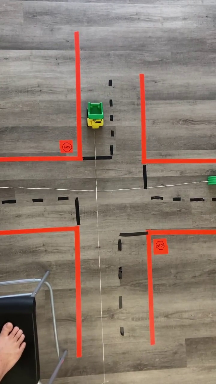

088.jp


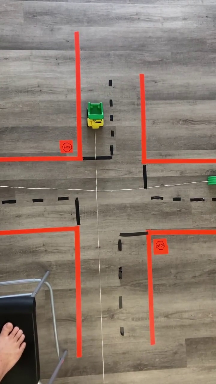

089.jp


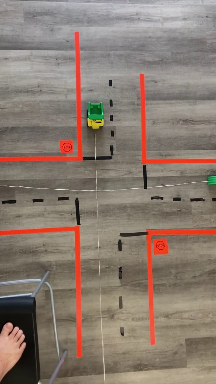

090.jp


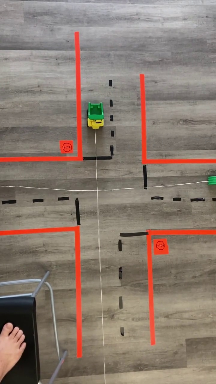

091.jp


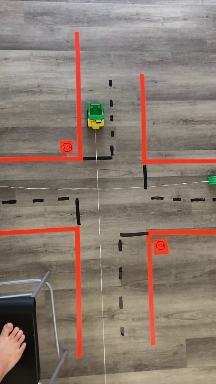

092.jp


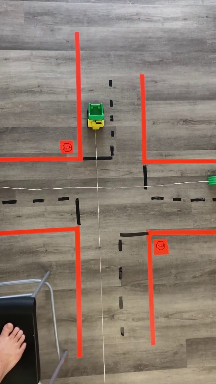

093.jp


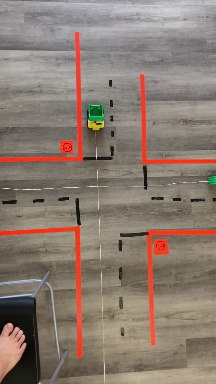

094.jp


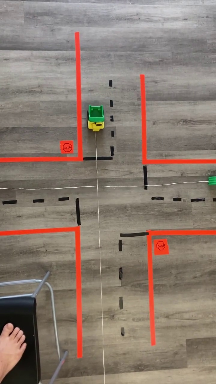

095.jp


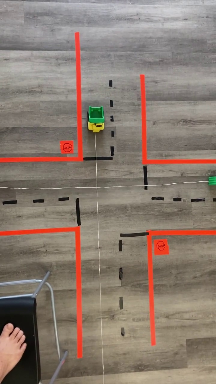

096.jp


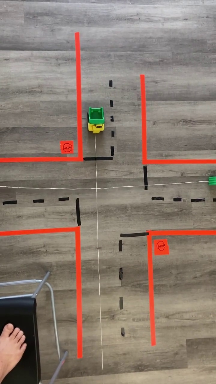

097.jp


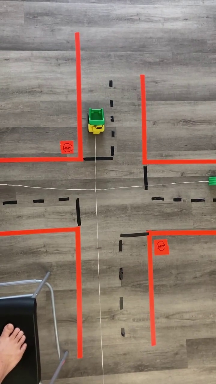

098.jp


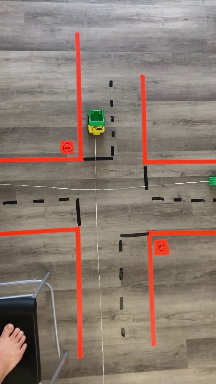

099.jp


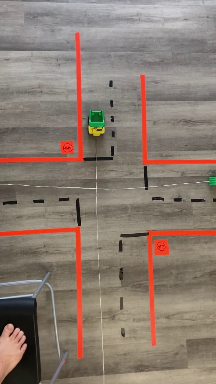

00.jp


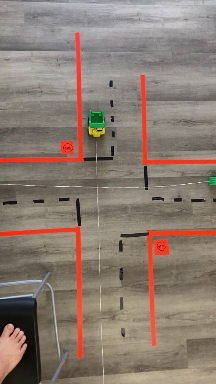

01.jp


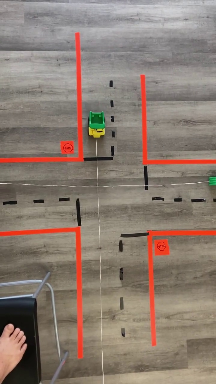

02.jp


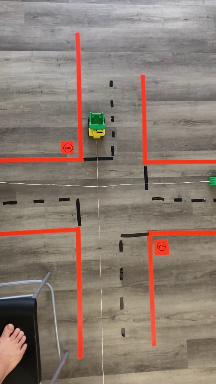

03.jp


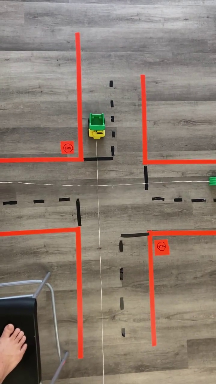

04.jp


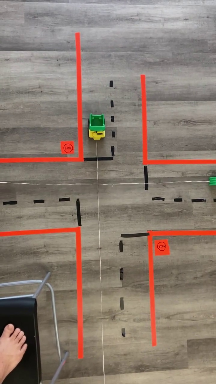

05.jp


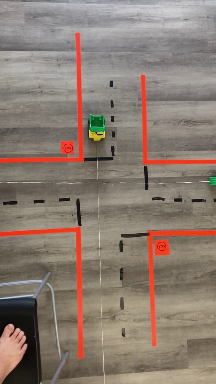

06.jp


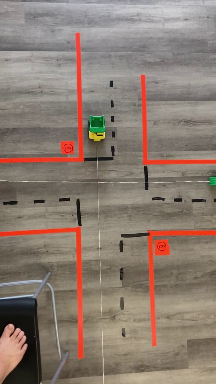

07.jp


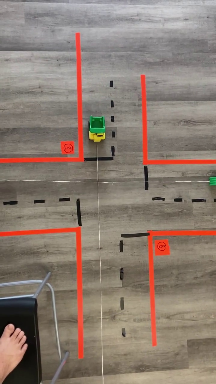

08.jp


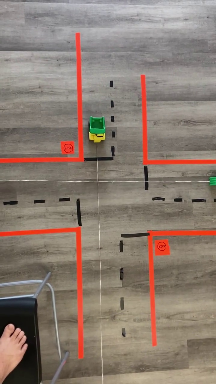

09.jp


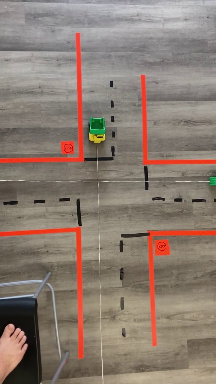

0.jp


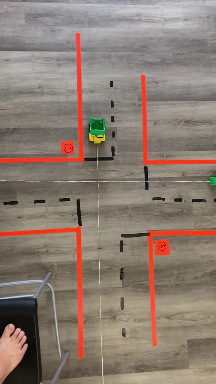

.jp


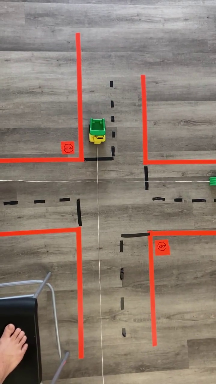

2.jp


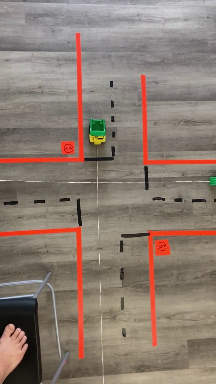

3.jp


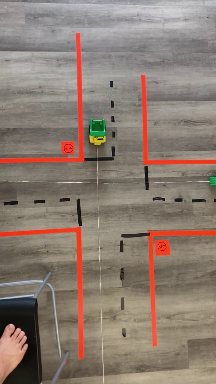

4.jp


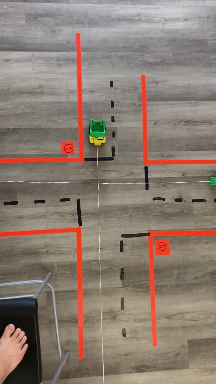

5.jp


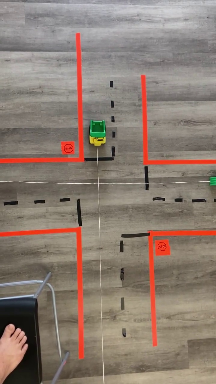

6.jp


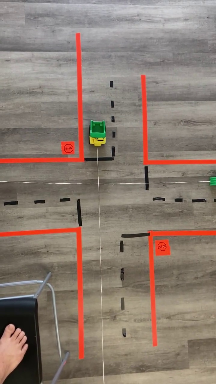

7.jp


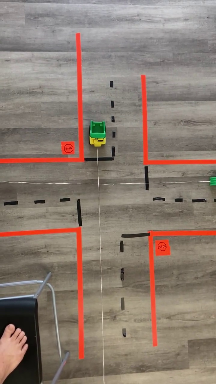

8.jp


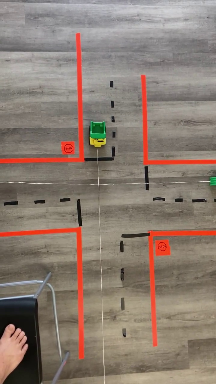

9.jp


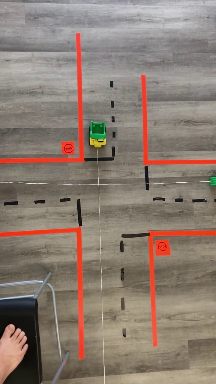

20.jp


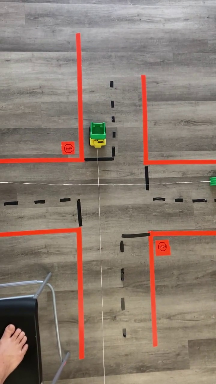

21.jp


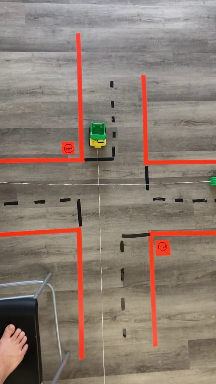

22.jp


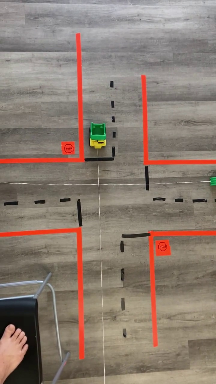

23.jp


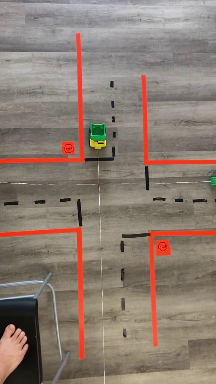

24.jp


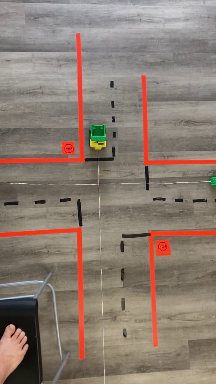

25.jp


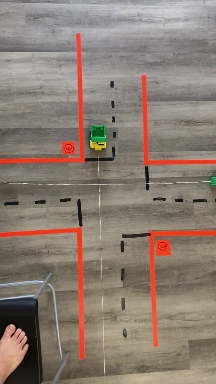

26.jp


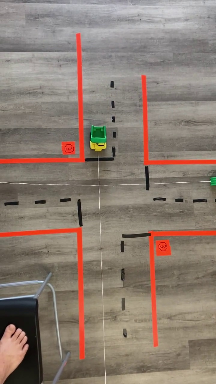

27.jp


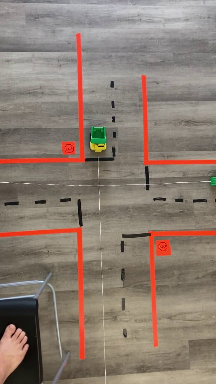

28.jp


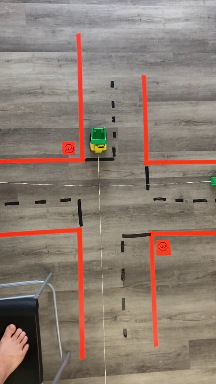

29.jp


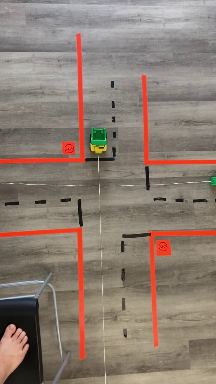

30.jp


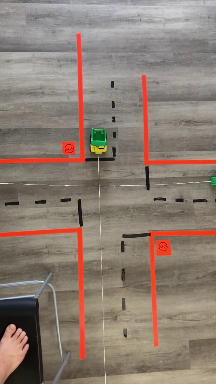

31.jp


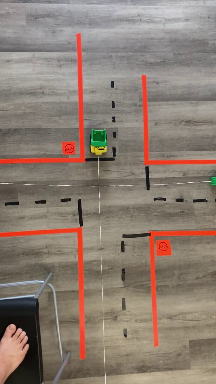

32.jp


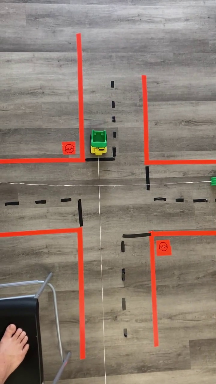

33.jp


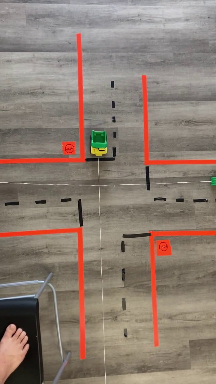

34.jp


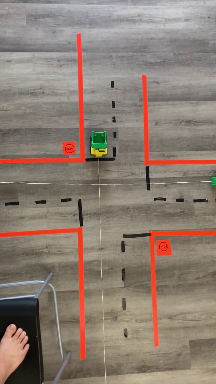

35.jp


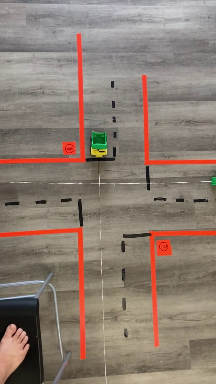

36.jp


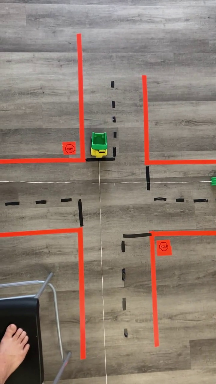

37.jp


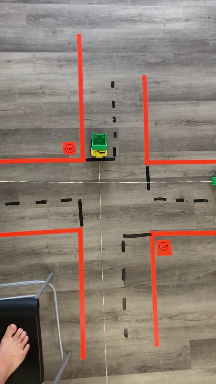

38.jp


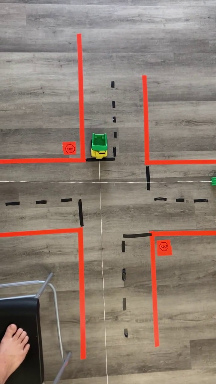

39.jp


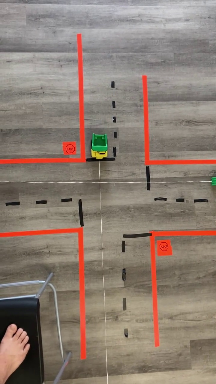

40.jp


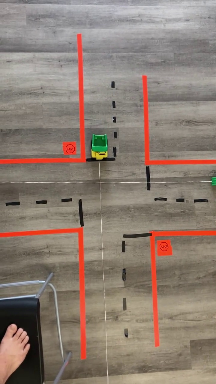

41.jp


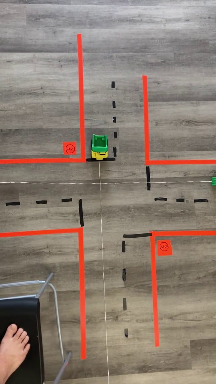

42.jp


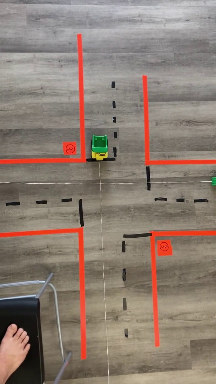

43.jp


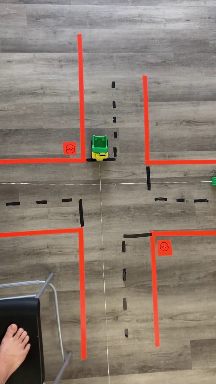

44.jp


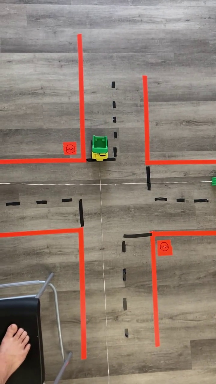

45.jp


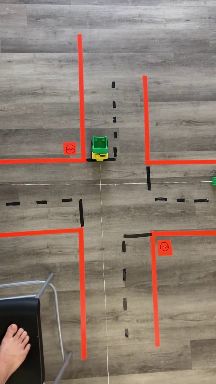

46.jp


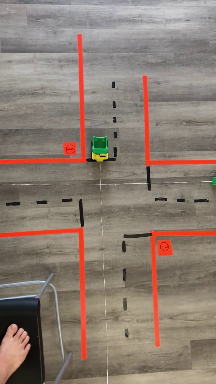

47.jp


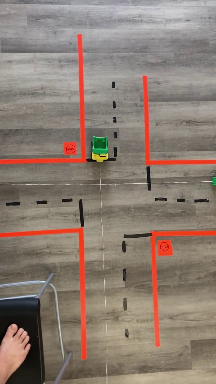

48.jp


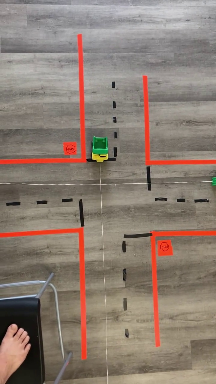

49.jp


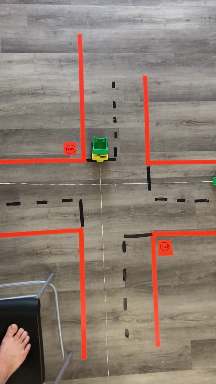

50.jp


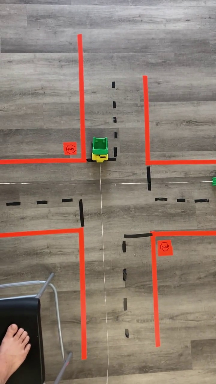

51.jp


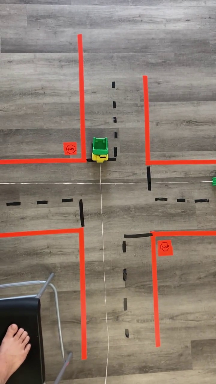

52.jp


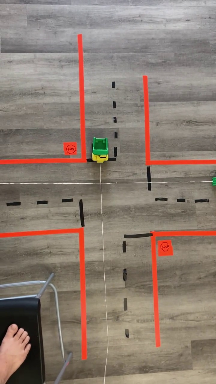

53.jp


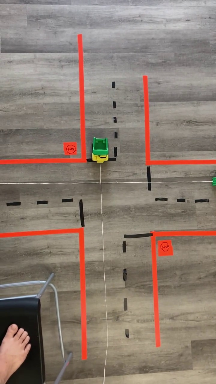

54.jp


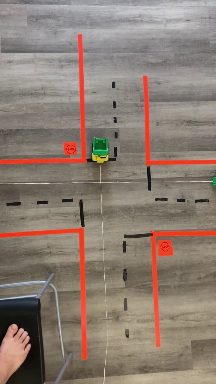

55.jp


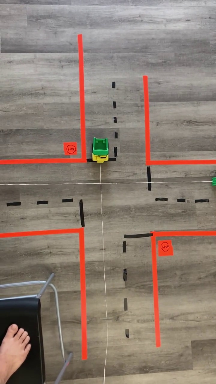

56.jp


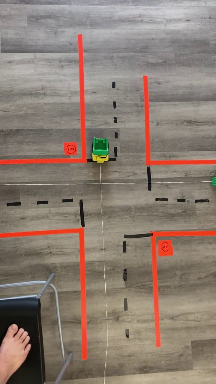

57.jp


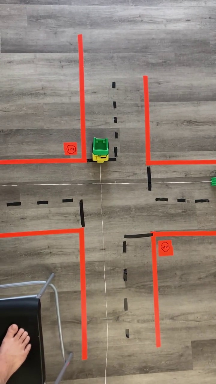

58.jp


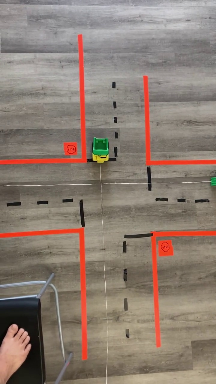

59.jp


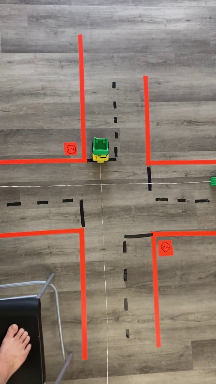

60.jp


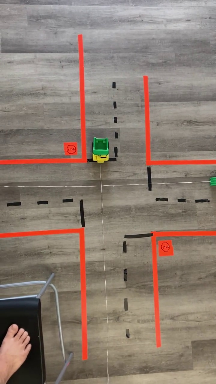

61.jp


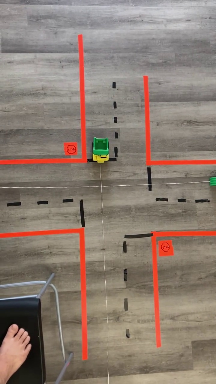

62.jp


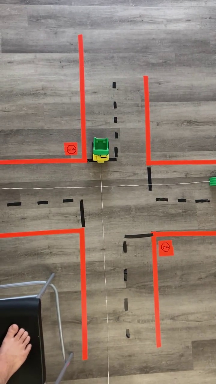

63.jp


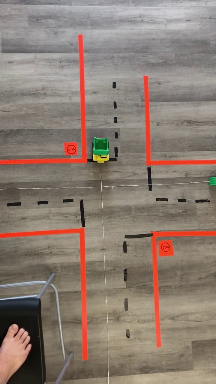

64.jp


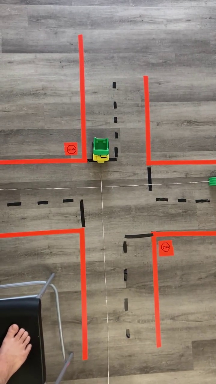

65.jp


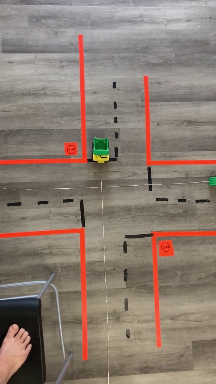

66.jp


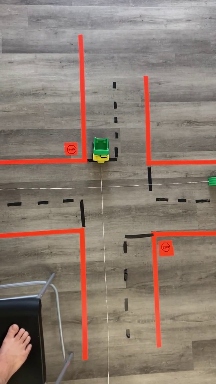

67.jp


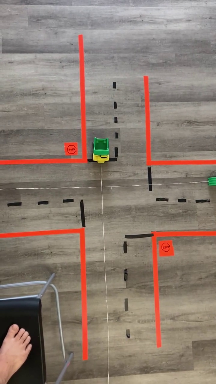

68.jp


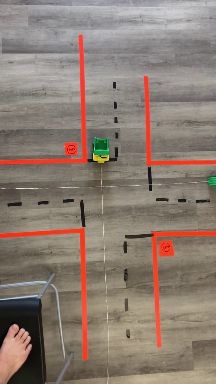

69.jp


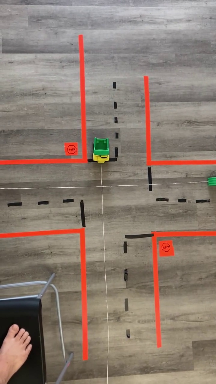

70.jp


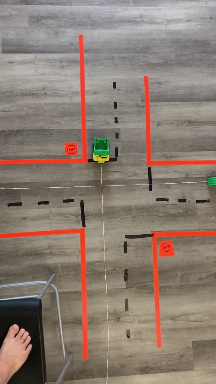

71.jp


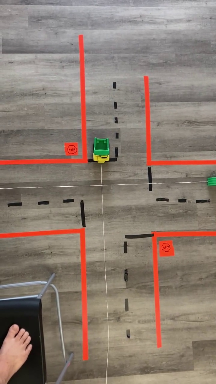

72.jp


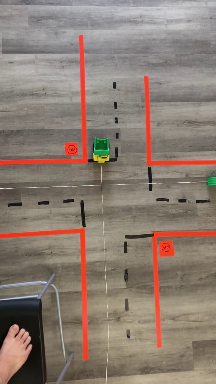

73.jp


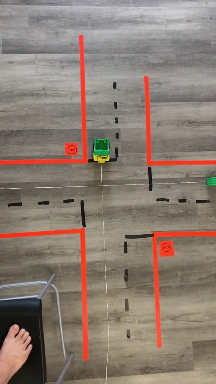

74.jp


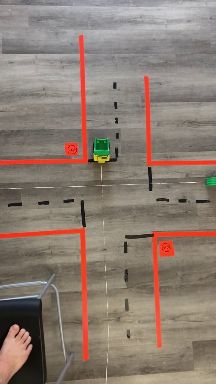

75.jp


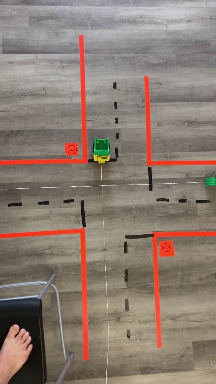

76.jp


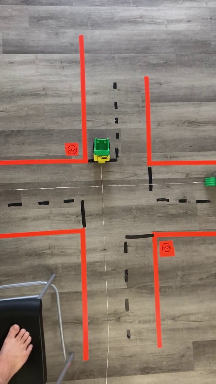

77.jp


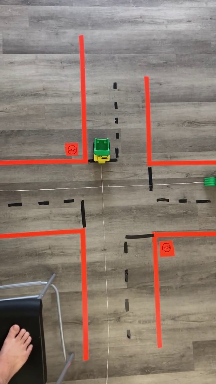

78.jp


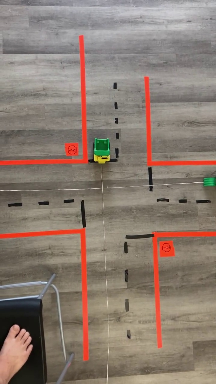

79.jp


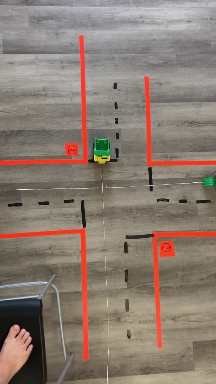

80.jp


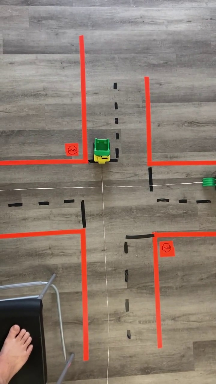

81.jp


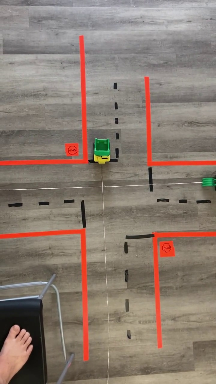

82.jp


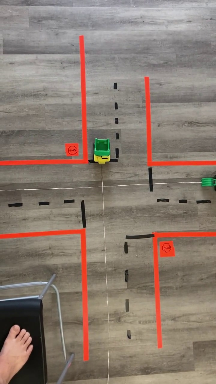

83.jp


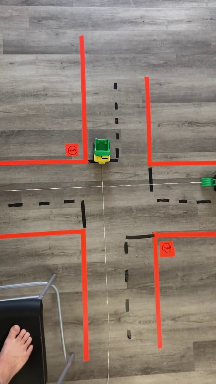

84.jp


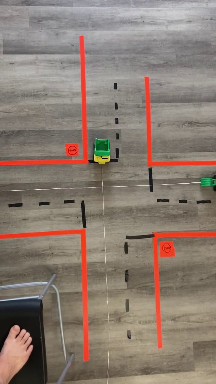

85.jp


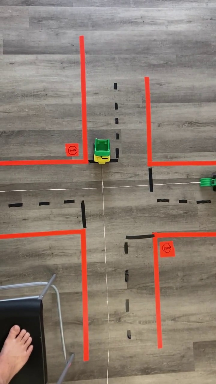

86.jp


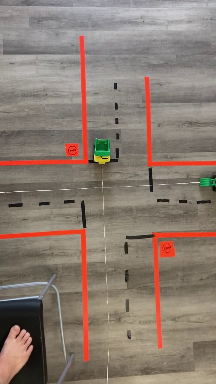

87.jp


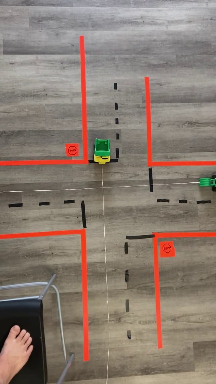

88.jp


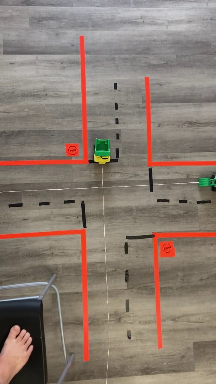

89.jp


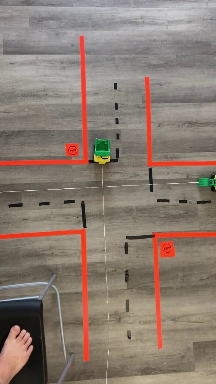

90.jp


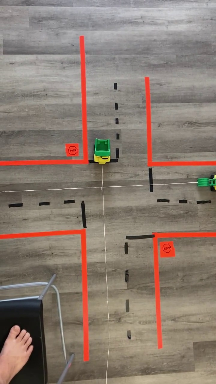

91.jp


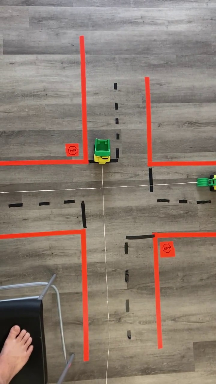

92.jp


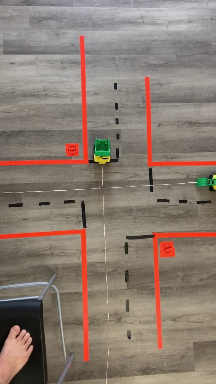

93.jp


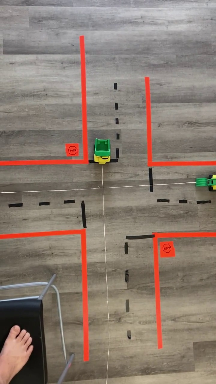

94.jp


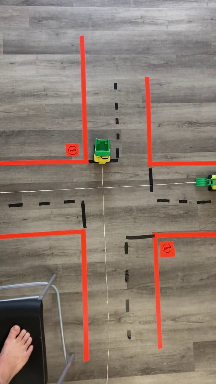

95.jp


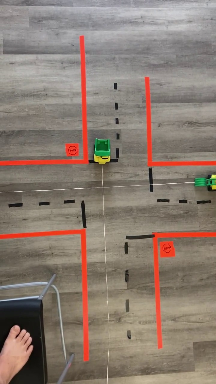

96.jp


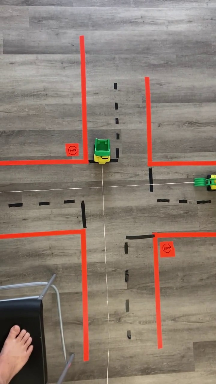

97.jp


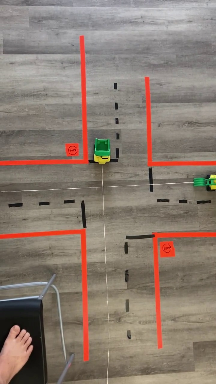

98.jp


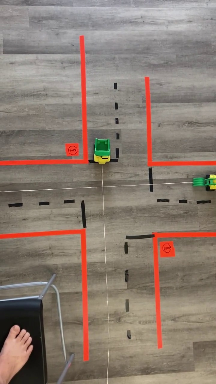

99.jp


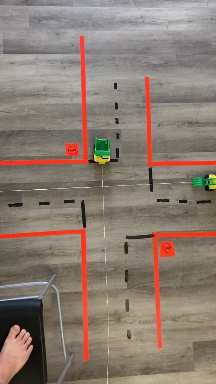

200.jp


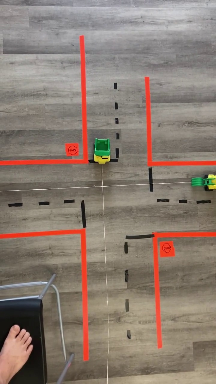

201.jp


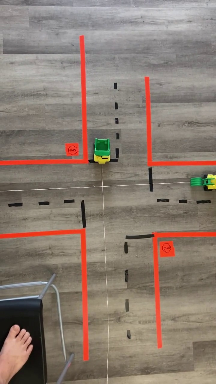

202.jp


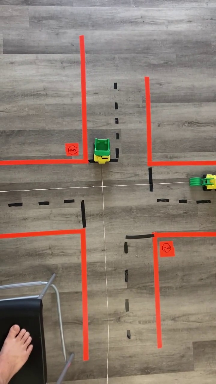

203.jp


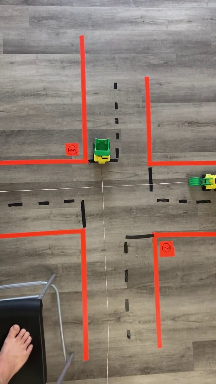

204.jp


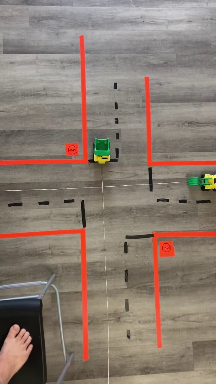

205.jp


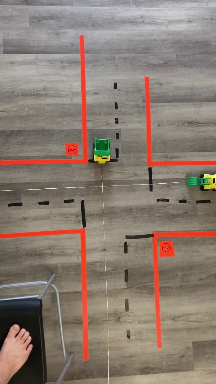

206.jp


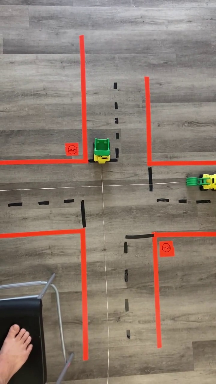

207.jp


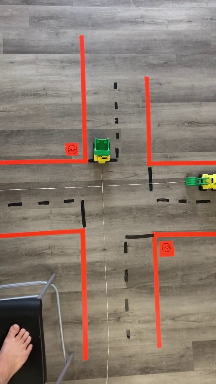

208.jp


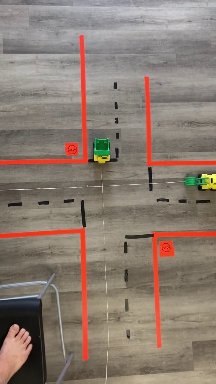

209.jp


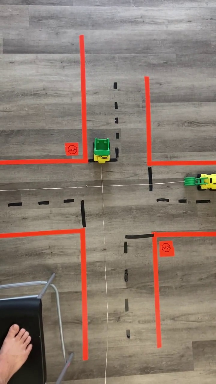

210.jp


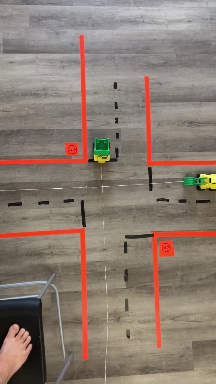

211.jp


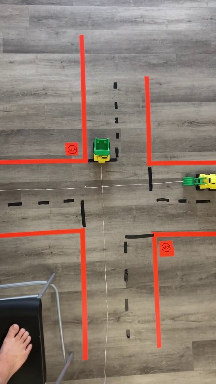

212.jp


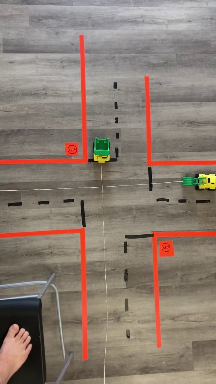

213.jp


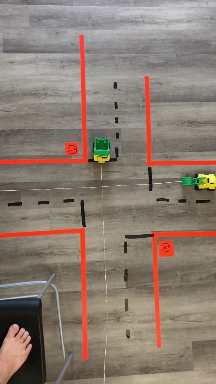

214.jp


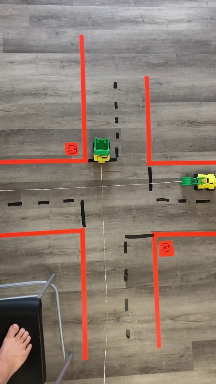

215.jp


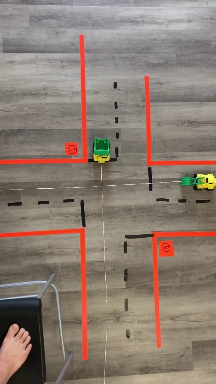

216.jp


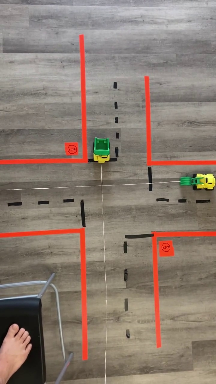

217.jp


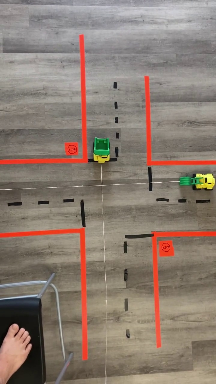

218.jp


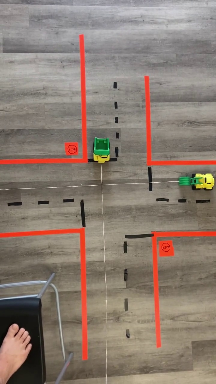

219.jp


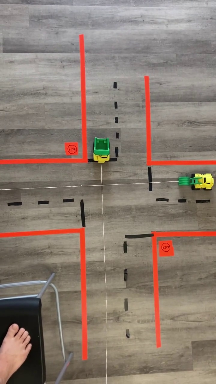

220.jp


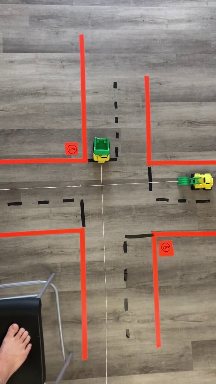

221.jp


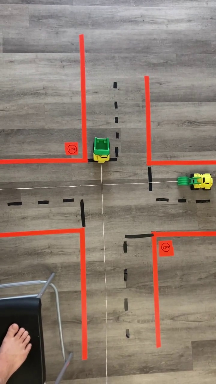

222.jp


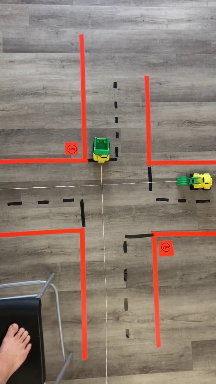

223.jp


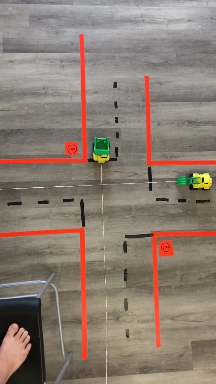

224.jp


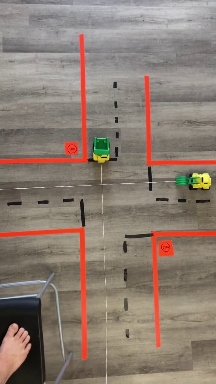

225.jp


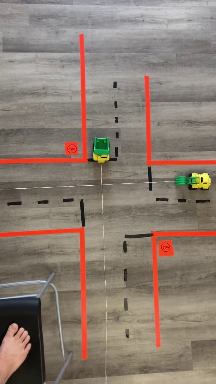

226.jp


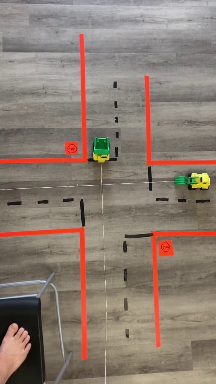

227.jp


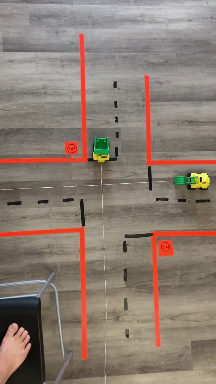

228.jp


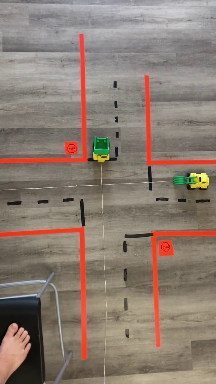

229.jp


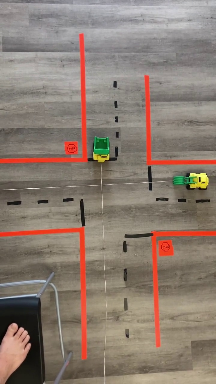

230.jp


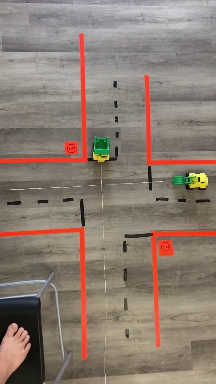

231.jp


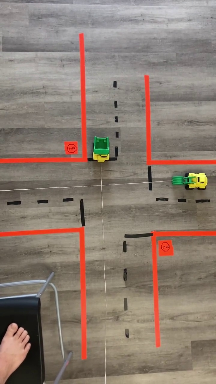

232.jp


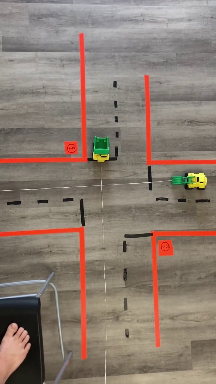

233.jp


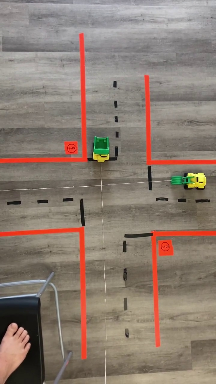

234.jp


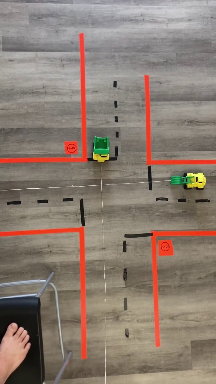

235.jp


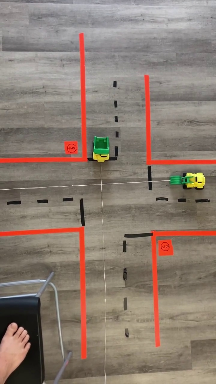

236.jp


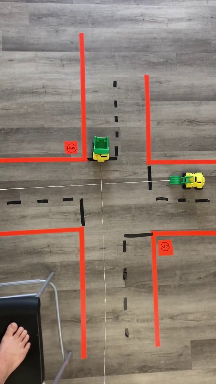

237.jp


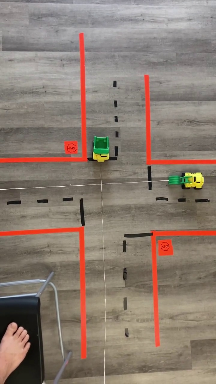

238.jp


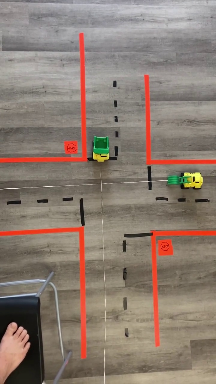

239.jp


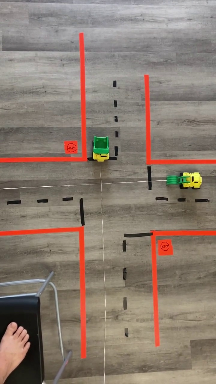

240.jp


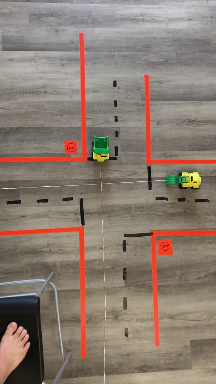

241.jp


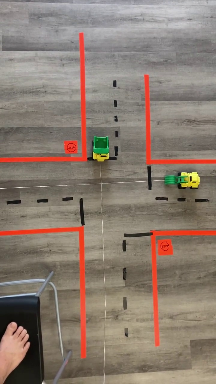

242.jp


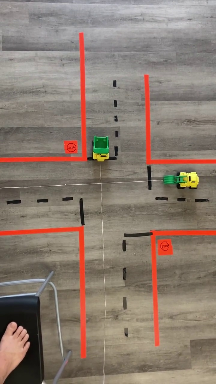

243.jp


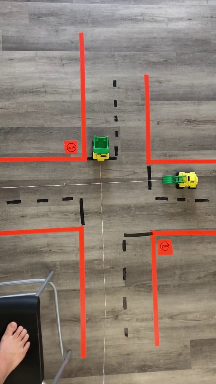

244.jp


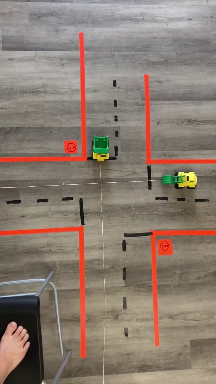

245.jp


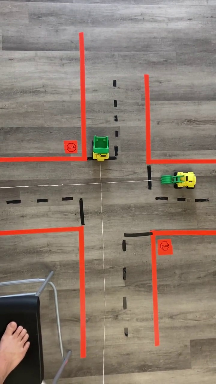

246.jp


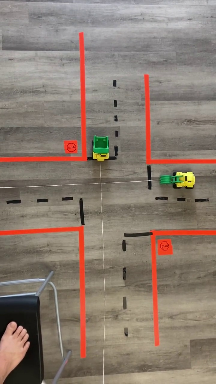

247.jp


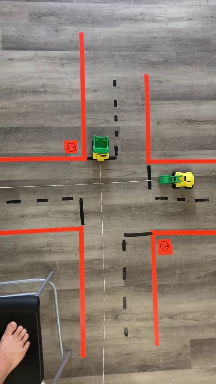

248.jp


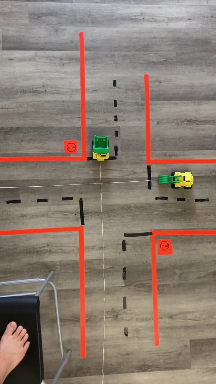

249.jp


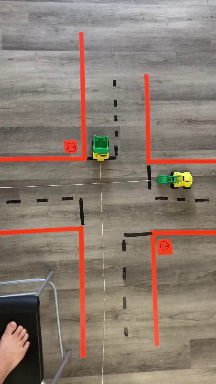

250.jp


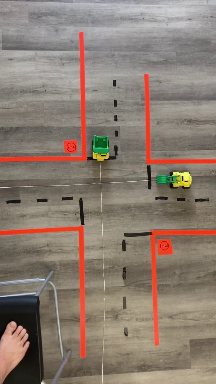

251.jp


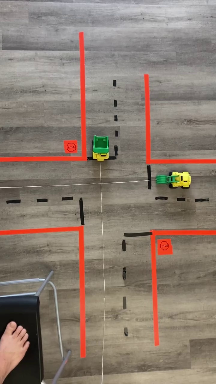

252.jp


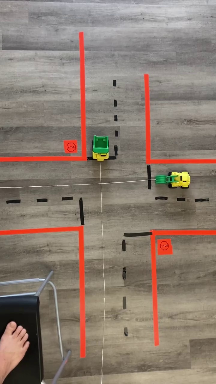

253.jp


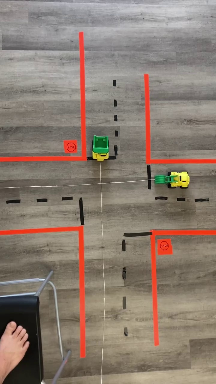

254.jp


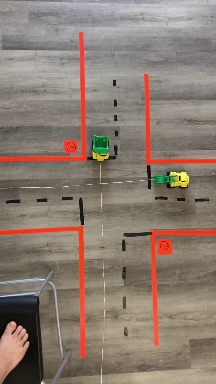

255.jp


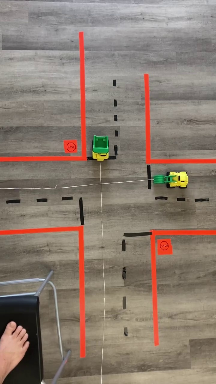

256.jp


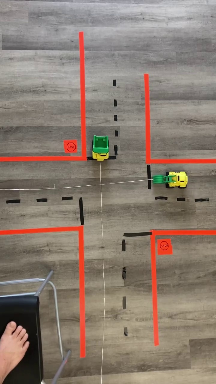

257.jp


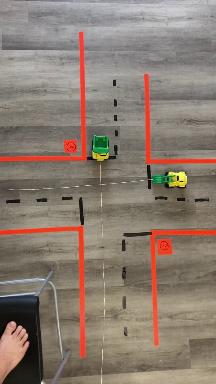

258.jp


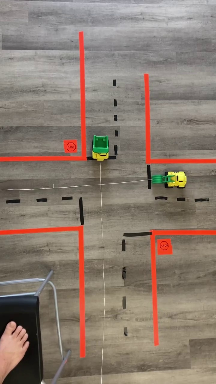

259.jp


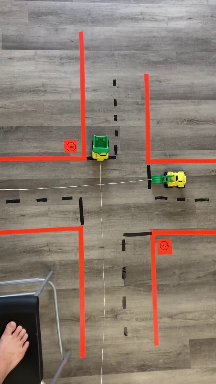

260.jp


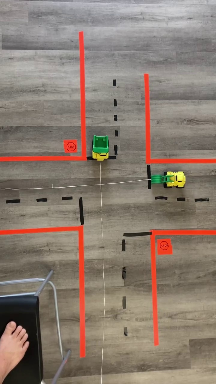

261.jp


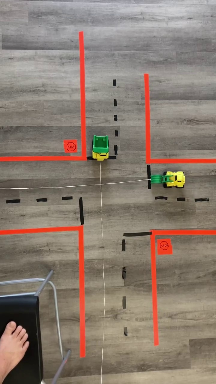

262.jp


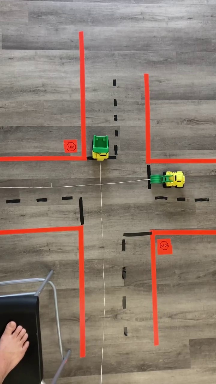

263.jp


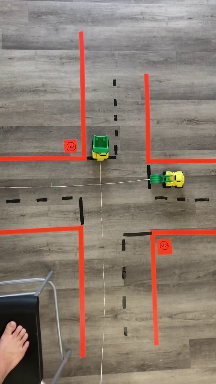

264.jp


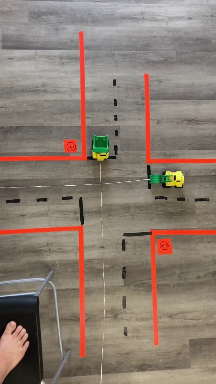

265.jp


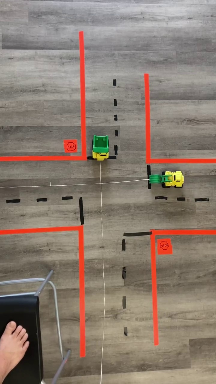

266.jp


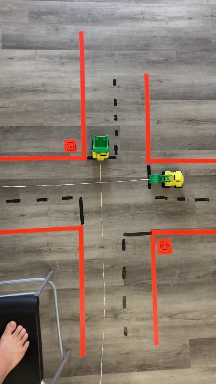

267.jp


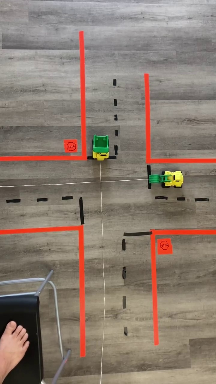

268.jp


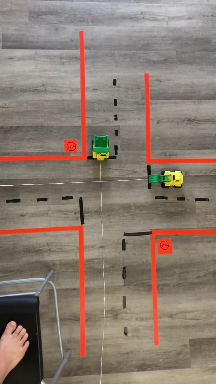

269.jp


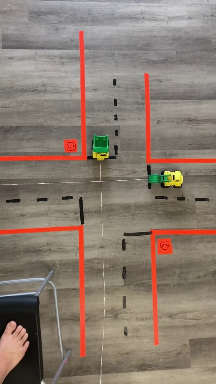

270.jp


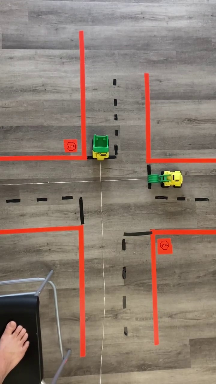

271.jp


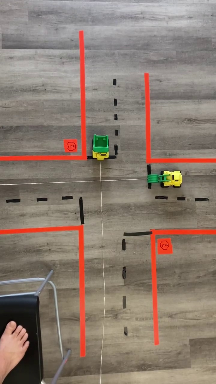

272.jp


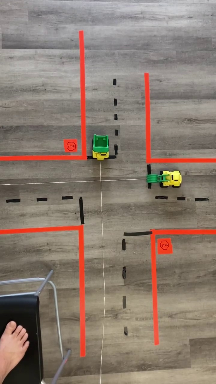

273.jp


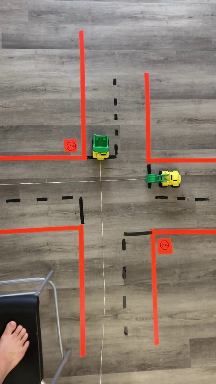

274.jp


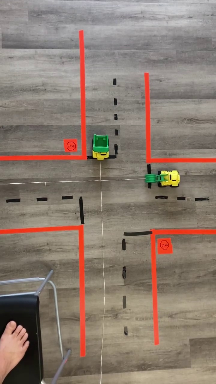

275.jp


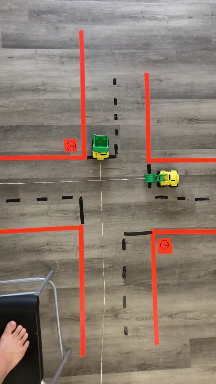

276.jp


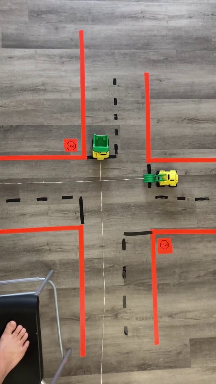

277.jp


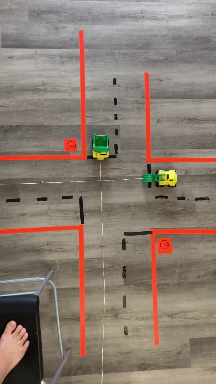

278.jp


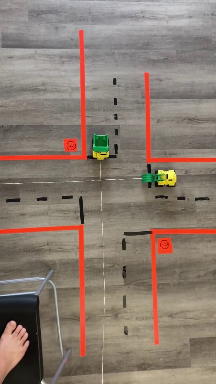

279.jp


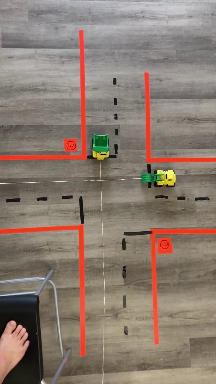

280.jp


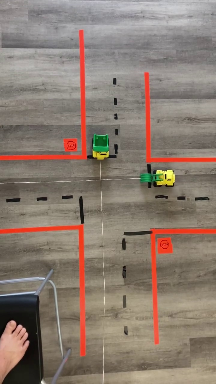

281.jp


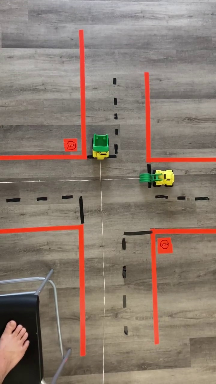

282.jp


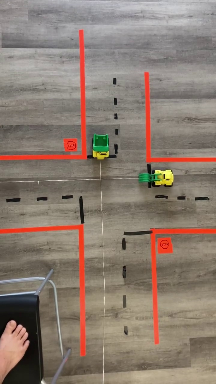

283.jp


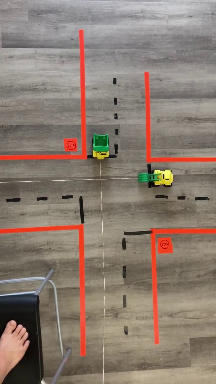

284.jp


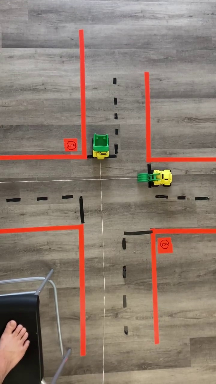

285.jp


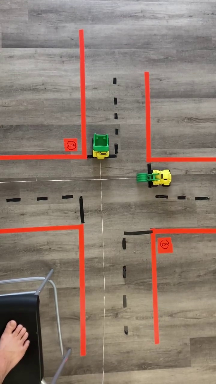

286.jp


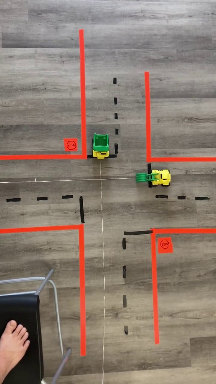

287.jp


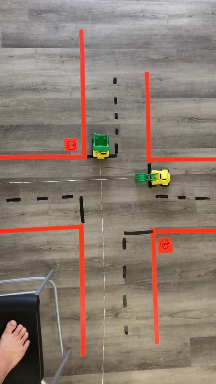

288.jp


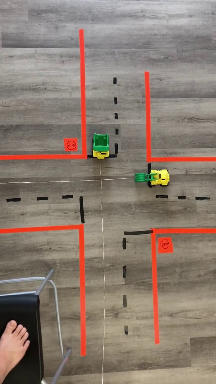

289.jp


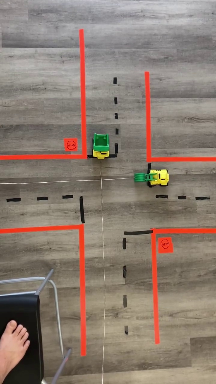

290.jp


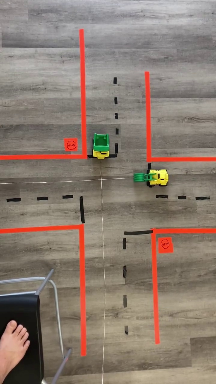

291.jp


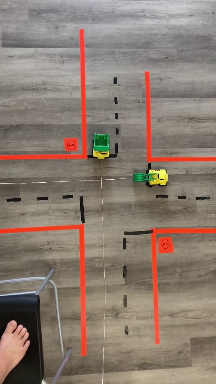

292.jp


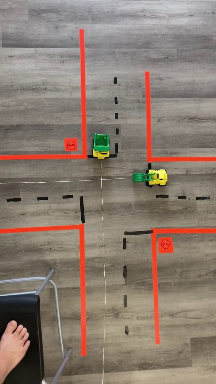

293.jp


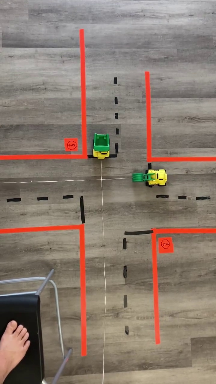

294.jp


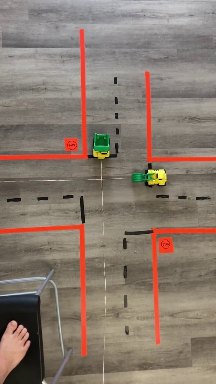

295.jp


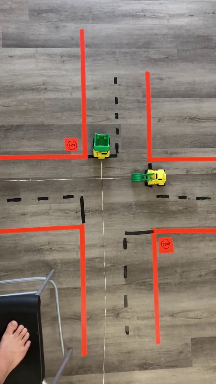

296.jp


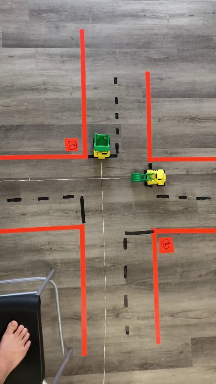

297.jp


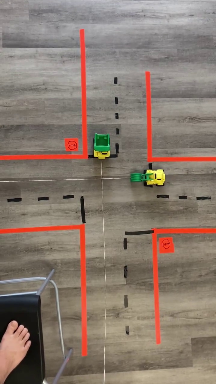

298.jp


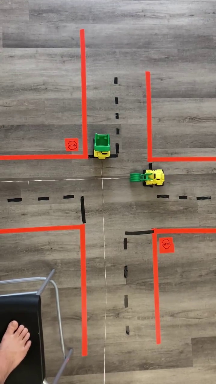

299.jp


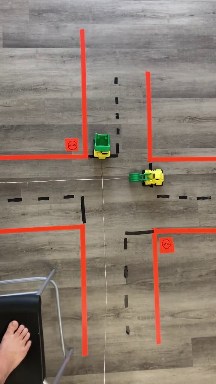

300.jp


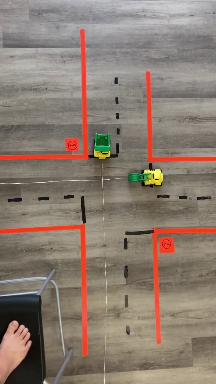

301.jp


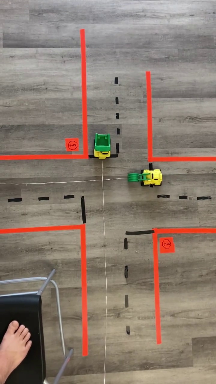

302.jp


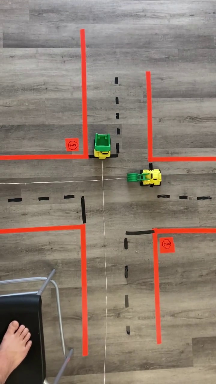

303.jp


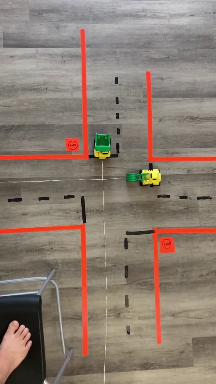

304.jp


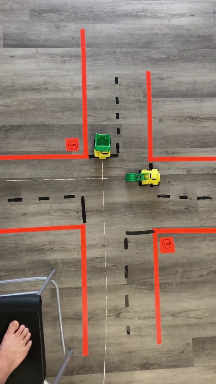

305.jp


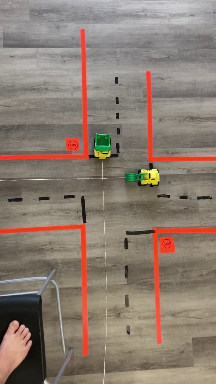

306.jp


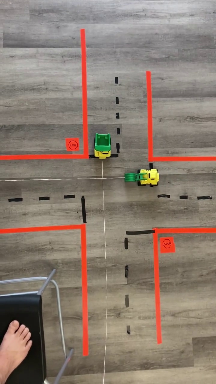

307.jp


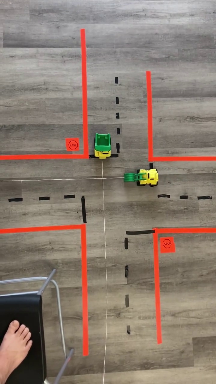

308.jp


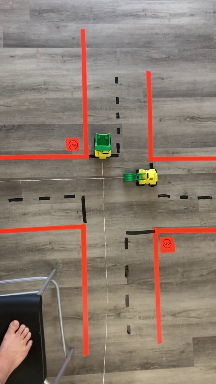

309.jp


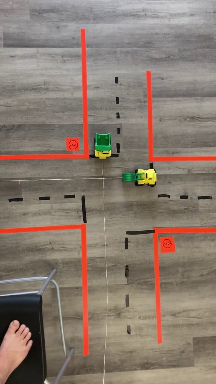

310.jp
Buffered data was truncated after reaching the output size limit.

In [ ]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
import glob
import os
widthheight = 320             
confidenceThreshold = 0.5     
nmsThreshold = 0.6            
font = cv.FONT_HERSHEY_SIMPLEX
colors = np.random.uniform(0, 255, size = (len(classNames),3)) 
path = "/content/Assignment_1/Images_from_video/"
pathFile = path + "*.*"                                    
files = sorted(glob.glob(pathFile), key = os.path.getmtime)  
frameSize = 0.3 
count = 10
for f in files:
  print(f.strip(path))
  frame = cv.imread(f)
  frame = cv.resize(frame,None,fx = frameSize, fy = frameSize)

  displayBox(getOutputs (frame))

  cv2_imshow(frame)
  cv.imwrite("/content/Assignment_1/final_images/frame%03d.jpg" %count, frame)
  count += 1

Make the final video 


In [ ]:
import cv2
import os

image_folder = '/content/Assignment_1/final_images'
video_name = 'Assignment_1_video.avi'

images = [img for img in os.listdir(image_folder) if img.endswith(".jpg")]
frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape

video = cv2.VideoWriter(video_name, 0, 1, (width,height))

for image in images:
    video.write(cv2.imread(os.path.join(image_folder, image)))

cv2.destroyAllWindows()
video.release()

**Download**

In [ ]:
from google.colab import files
files.download('/content/Assignment_1_video.avi')